In [1]:
import matplotlib.pyplot as plt
from astropy.nddata import CCDData
from astropy.io import fits
from ccdproc import *
from astropy.visualization import hist
import numpy as np
import sys
np.set_printoptions(threshold=sys.maxsize)
from pathlib import Path
from convenience_functions import show_image #convenience function is a separate file to show an image

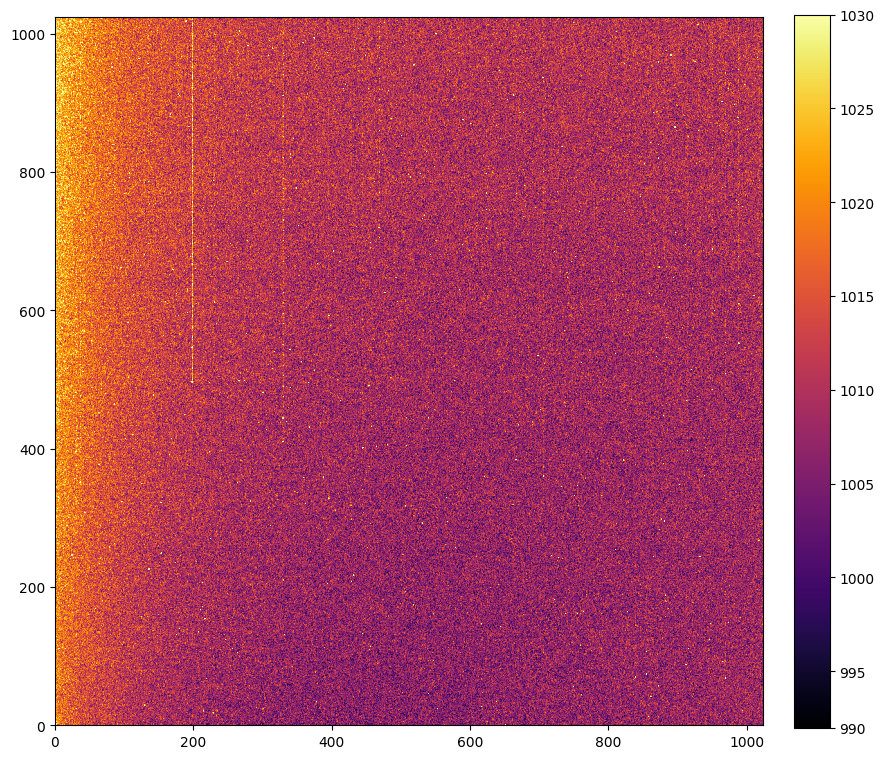

In [2]:
#4.1.1 - Opening the image for bias frame at 0◦C
bias_image = CCDData.read('bias_frame.00000000.BIAS.FIT', unit='adu')
show_image(bias_image.data, cmap='inferno')

[]

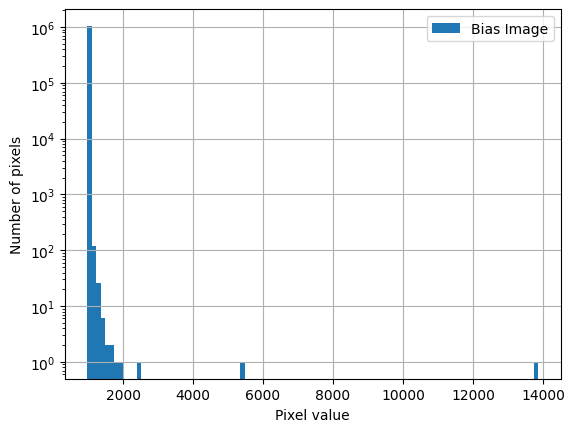

In [3]:
#4.1.1 - Plotting the histogram of the distribution of counts for the bias frame
data = bias_image.data.flatten()
hist(data, bins=100, label='Bias Image')
plt.grid()
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')
plt.semilogy() #y-axis in log-scale

Text(0, 0.5, 'Number of pixels')

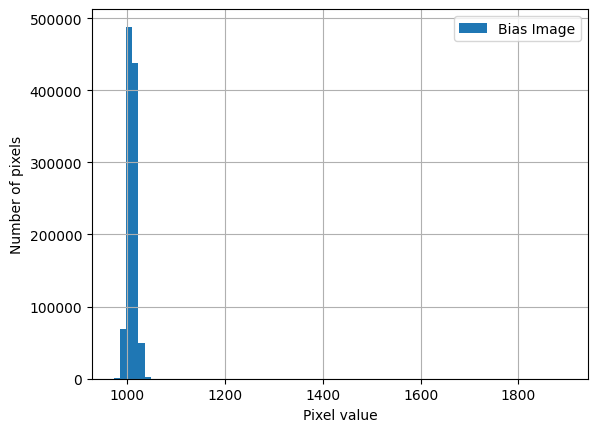

In [4]:
#4.1.1 - Defining a cut that rejects any hot pixels and plotting the cut histogram 
data_cut = data[data<2000]
hist(data_cut, bins=75, label='Bias Image')
plt.grid()
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')

In [5]:
#4.1.1 - Fraction of pixels that get rejected
count = 0
for i in range(len(data)):
    if bias_image.data.flatten()[i] > 1060:
        count = count + 1
print(f"The fraction of pixels that got rejected is {count / len(data)}")

The fraction of pixels that got rejected is 0.0003871917724609375


In [6]:
#4.1.2 - Calculating the standard deviation and mean for Gaussian Curve
std = np.std(data_cut)
print(f'standard deviation is {std}')
mean = np.mean(data_cut)
print(f'mean is {mean}')
uncert = std/(1024)
print(f'uncertainity is: {uncert}')

standard deviation is 8.499324106312372
mean is 1010.1403488359895
uncertainity is: 0.008300121197570676


In [7]:
#4.1.2 - Defining the Gaussian function
def g(sigma,u,x):
    return 1/(sigma*(np.sqrt(2*np.pi))) * np.exp(-(x - u)**2 / (2*sigma**2))

Text(0, 0.5, 'Number of pixels')

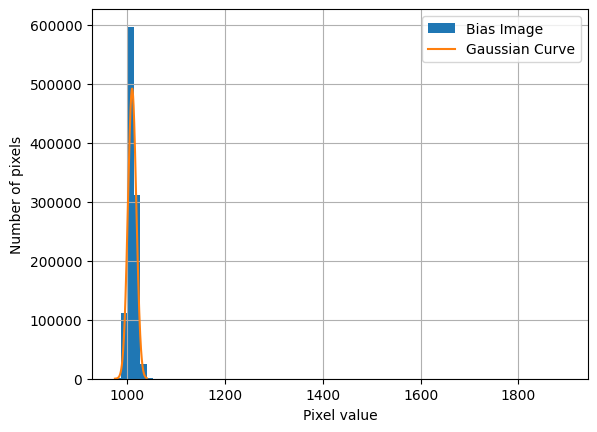

In [8]:
#4.1.2 - Plotting a cut histogram with the Gaussian fit
x = np.linspace(975,1040,1040)
hist(data_cut, bins=70, label='Bias Image')
plt.plot(x, 10485760*g(std,mean,x), label='Gaussian Curve')
plt.grid()
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')

$$\text{read noise} = \frac{\sigma \times \text{gain}}{\sqrt{2}}$$

In [9]:
#4.1.2 - Bias method for read noise
bias_data_cut = data_cut
read_noise = np.std(bias_data_cut) * 2.06/ np.sqrt(2)
print(f"Read noise in units of electrons: {read_noise}")

Read noise in units of electrons: 12.380455204816089


In [10]:
#4.2.1 - Combining 10 dark images with 30s exposure time and finding median
ccd1 = CCDData.read('dark_frame_30s.06.DARK.FIT', unit='adu')
ccd2 = CCDData.read('dark_frame_30s.07.DARK.FIT', unit='adu')
ccd3 = CCDData.read('dark_frame_30s.08.DARK.FIT', unit='adu')
ccd4 = CCDData.read('dark_frame_30s.09.DARK.FIT', unit='adu')
ccd5 = CCDData.read('dark_frame_30s.10.DARK.FIT', unit='adu')
ccd6 = CCDData.read('dark_frame_30s.11.DARK.FIT', unit='adu')
ccd7 = CCDData.read('dark_frame_30s.12.DARK.FIT', unit='adu')
ccd8 = CCDData.read('dark_frame_30s.13.DARK.FIT', unit='adu')
ccd9 = CCDData.read('dark_frame_30s.14.DARK.FIT', unit='adu')
ccd10 = CCDData.read('dark_frame_30s.15.DARK.FIT', unit='adu')

combiner = Combiner([ccd1, ccd2, ccd3, ccd4, ccd5, ccd6, ccd7, ccd8, ccd9, ccd10])
combined_median = np.array(combiner.median_combine())

In [11]:
#4.2.1 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median)
hdul = fits.HDUList([hdu])
hdu.writeto('master_dark_frame_30s.DARK.FIT')

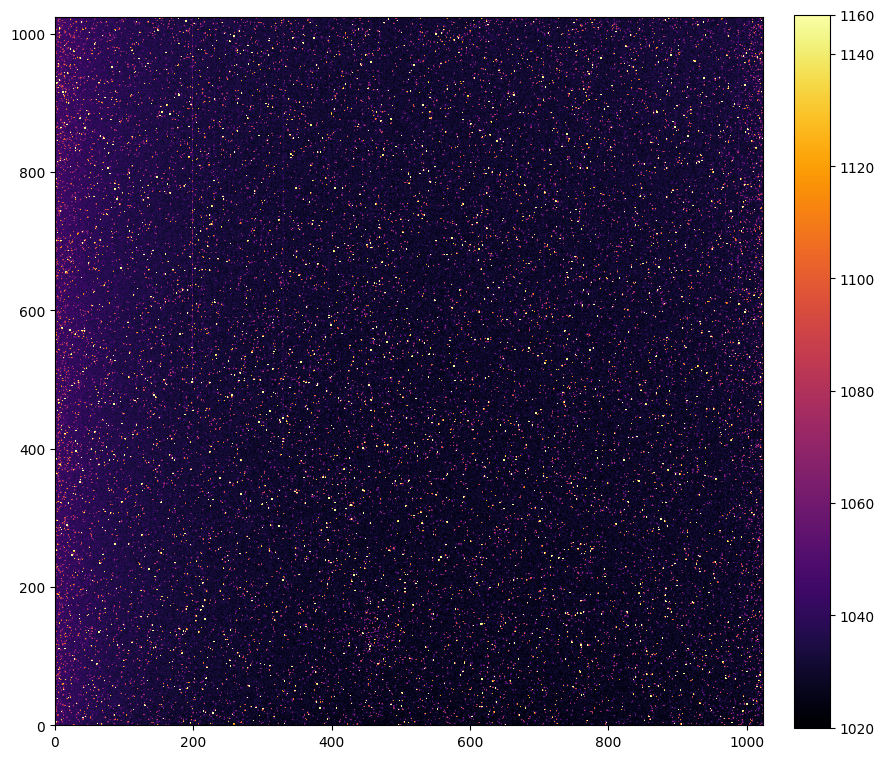

In [12]:
#4.2.1 - Master Dark Frame
dark_image = CCDData.read('master_dark_frame_30s.DARK.FIT', unit='adu')
show_image(dark_image.data, cmap='inferno')

[]

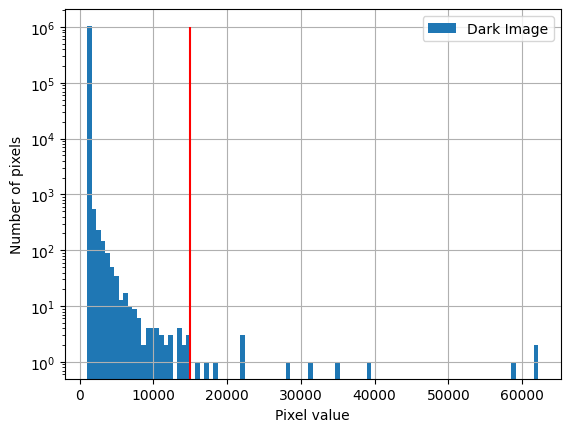

In [13]:
#4.2.1 - Plot Master Dark Image Histogram
dark0 = dark_image.data.flatten()
hist(dark0, bins=100, label='Dark Image')
plt.grid()
plt.vlines(15000,0,1e6, colors='red')
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')
plt.semilogy() #y-axis in log-scale

[]

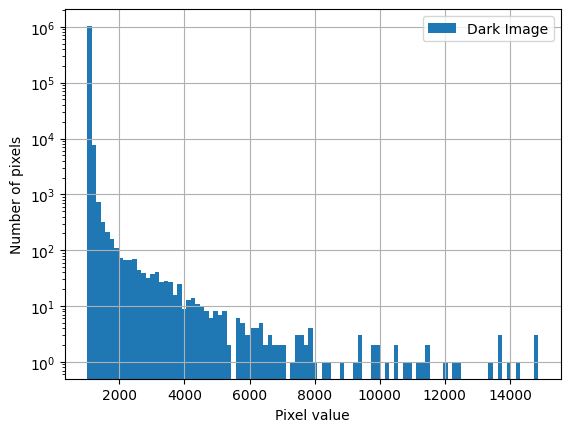

In [14]:
#4.2.1 - Plot Cut Histogram
dark_cut0 = dark0[dark0<15000]
hist(dark_cut0, bins=100, label='Dark Image')
plt.grid()
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')
plt.semilogy() #y-axis in log-scale

In [15]:
#4.2.2 - Opening and reading each dark frame in the time series
ccd11 = CCDData.read('dark_frame_10s.05.DARK.FIT', unit='adu')
dark_10s = ccd11.data.flatten()
dark_10s_cut = dark_10s[dark_10s < 15000]
dark_30s = ccd10.data.flatten()
dark_30s_cut = dark_30s[dark_30s < 15000]
ccd12 = CCDData.read('dark_frame_60s.16.DARK.FIT', unit='adu')
dark_60s = ccd12.data.flatten()
dark_60s_cut = dark_60s[dark_60s < 15000]
ccd13 = CCDData.read('dark_frame_90s.17.DARK.FIT', unit='adu')
dark_90s = ccd13.data.flatten()
dark_90s_cut = dark_90s[dark_90s < 15000]
ccd14 = CCDData.read('dark_frame_120s.18.DARK.FIT', unit='adu')
dark_120s = ccd14.data.flatten()
dark_120s_cut = dark_120s[dark_120s < 15000]

In [16]:
#4.2.2 - Mean, Standard Deviation and Uncertainity for 10s Dark Frame
mean10 = np.mean(dark_10s_cut)
std10 = np.std(dark_10s_cut)
uncert10 = std10/(np.sqrt(1024**2))
print(f'The mean of the data is: {mean10}')
print(f'The standard deviation of the data is: {std10}')
print(f'The uncertainity of the data is: {uncert10}')

The mean of the data is: 1016.6903954231132
The standard deviation of the data is: 43.874405847985756
The uncertainity of the data is: 0.04284609946092359


In [17]:
#4.2.2 - Mean, Standard Deviation and Uncertainity for 60s Dark Frame
mean60 = np.mean(dark_60s_cut)
std60 = np.std(dark_60s_cut)
uncert60 = std60/(np.sqrt(1024**2))
print(f'The mean of the data is: {mean60}')
print(f'The standard deviation of the data is: {std60}')
print(f'The uncertainity of the data is: {uncert60}')

The mean of the data is: 1062.4348267285184
The standard deviation of the data is: 141.38562569891172
The uncertainity of the data is: 0.13807190009659348


In [18]:
#4.2.2 - Mean, Standard Deviation and Uncertainity for 90s Dark Frame
mean90 = np.mean(dark_90s_cut)
std90 = np.std(dark_90s_cut)
uncert90 = std90/(np.sqrt(1024**2))
print(f'The mean of the data is: {mean90}')
print(f'The standard deviation of the data is: {std90}')
print(f'The uncertainity of the data is: {uncert90}')

The mean of the data is: 1089.553274709344
The standard deviation of the data is: 181.85343252655036
The uncertainity of the data is: 0.17759124270170934


In [19]:
#4.2.2 - Mean, Standard Deviation and Uncertainity for 30s Dark Frame
mean30 = np.mean(dark_30s_cut)
std30 = np.std(dark_30s_cut)
uncert30 = std30/1024

In [20]:
#4.2.2 - Mean, Standard Deviation and Uncertainity for 120s Dark Frame
mean120 = np.mean(dark_120s_cut)
std120 = np.std(dark_120s_cut)
uncert120 = std120/(np.sqrt(1024**2))
print(f'The mean of the data is: {mean120}')
print(f'The standard deviation of the data is: {std120}')
print(f'The uncertainity of the data is: {uncert120}')

The mean of the data is: 1115.7015448681325
The standard deviation of the data is: 213.62654431281496
The uncertainity of the data is: 0.20861967218048336


In [21]:
#4.2.2 - Creating an array of each dark frame
mean_counts = np.array([mean, mean10, mean30, mean60, mean90, mean120])
print(mean_counts)

#Creating an array of each exposure time
exp_time = np.array([0, 10, 30, 60, 90, 120]) 
print(exp_time)

[1010.14034884 1016.69039542 1035.52157145 1062.43482673 1089.55327471
 1115.70154487]
[  0  10  30  60  90 120]


1008.9943566861658 0.8905671674047515


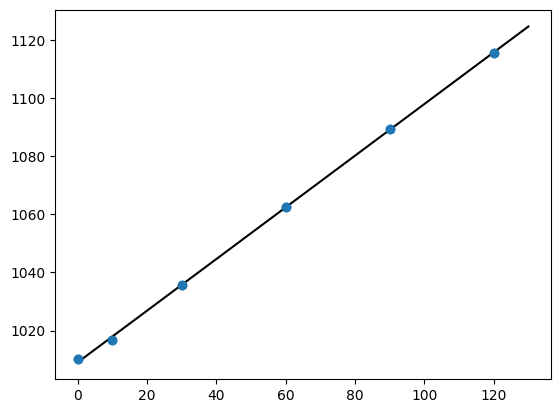

In [22]:
#4.2.2 - Making a scatter plot of the mean counts versus the exposure time
plt.scatter(exp_time, mean_counts)
b, a = np.polyfit(exp_time, mean_counts, deg=1)
xseq = np.linspace(0, 130, 6)
plt.plot(xseq, a + b * xseq, color="k", lw=1.5)

#Creating an array of the uncertainty values
yerr = np.array([uncert, uncert10, uncert60, uncert60, uncert90, uncert120])

#Adding error bars into the plot
plt.errorbar(exp_time, mean_counts, yerr = yerr, fmt='o')
print(a,b)

<ErrorbarContainer object of 3 artists>

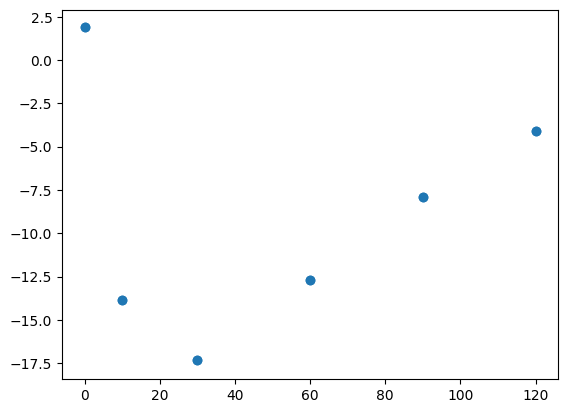

In [23]:
#4.2.2 - Making a second plot of the residuals of the data points, with uncertainties, relative to the linear regression in the previous plot
def residual(a,b, xseq):
    return mean_counts - (a + b * xseq)

plt.scatter(exp_time, residual(1008.2142894895652,0.8582815152075286, xseq))
yerr = np.array([uncert, uncert10, uncert60, uncert60, uncert90, uncert120])
plt.errorbar(exp_time, residual(1008.2142894895652,0.8582815152075286, xseq), yerr = yerr, fmt='o')

This plot demonstrates that the line of best fit is a good description of the data since it shows that the data is randomly scattered above and below the line of best fit.

In [24]:
#4.2.2 - Dark Current in electrons per pixel per second 
dark_current = 2.06 * b
print(dark_current)

1.834568364853788


In [25]:
#4.2.2 - Dark image at another temperature; read in the image file for the dark frame taken at 10 degrees Celsius
ten_celsius = CCDData.read('dark_frame_tenC.20.DARK.FIT', unit='adu')

In [26]:
#4.3.1 - Reading in the Flat-field Images, combining to take the median of the ten flat fields and normalizing it for the master flat-field
flat1 = CCDData.read('flat_fields_frame.00000005.FIT', unit='adu')
flat2 = CCDData.read('flat_fields_frame.00000006.FIT', unit='adu')
flat3 = CCDData.read('flat_fields_frame.00000007.FIT', unit='adu')
flat4 = CCDData.read('flat_fields_frame.00000008.FIT', unit='adu')
flat5 = CCDData.read('flat_fields_frame.00000009.FIT', unit='adu')
flat6 = CCDData.read('flat_fields_frame.00000010.FIT', unit='adu')
flat7 = CCDData.read('flat_fields_frame.00000011.FIT', unit='adu')
flat8 = CCDData.read('flat_fields_frame.00000012.FIT', unit='adu')
flat9 = CCDData.read('flat_fields_frame.00000013.FIT', unit='adu')
flat10 = CCDData.read('flat_fields_frame.00000014.FIT', unit='adu')

combiner_flats = Combiner([flat1, flat2, flat3, flat4, flat5, flat6, flat7, flat8, flat9, flat10])
combined_median_flats = np.array(combiner_flats.median_combine())
mean_flats = np.mean(combined_median_flats)
normed = combined_median_flats/mean_flats

In [27]:
#4.3.1 - Making new FIT file from median array
hdu_flats = fits.PrimaryHDU(normed)
hdul_flats = fits.HDUList([hdu_flats])
hdu_flats.writeto('normed_master_flat.FIT')

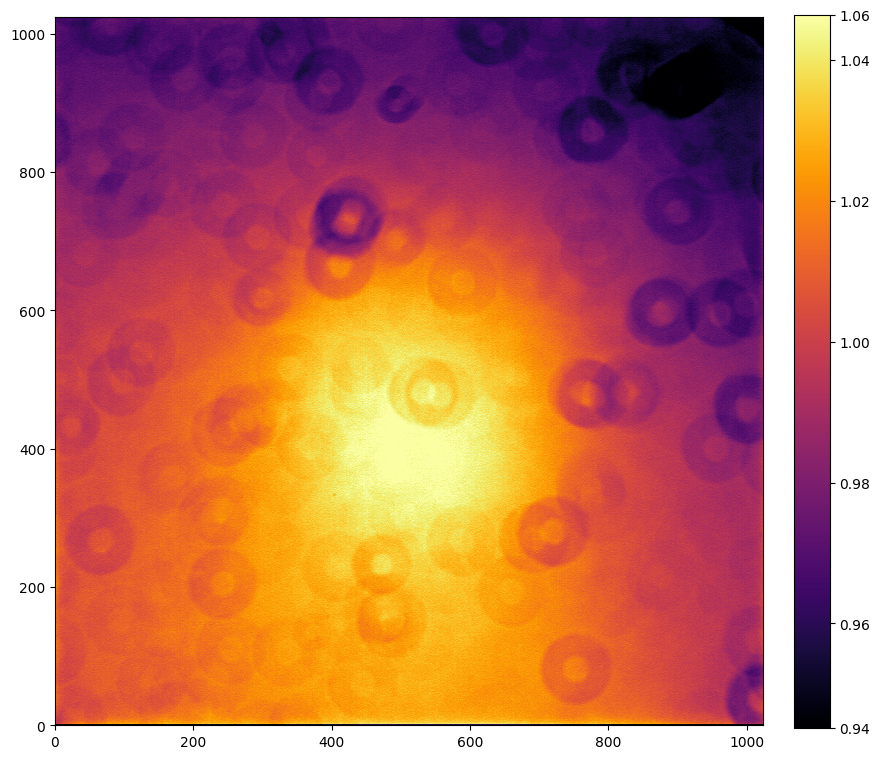

In [28]:
#4.3.1 - Master flat-field
flat_image = CCDData.read('normed_master_flat.FIT', unit='adu')
show_image(flat_image.data, cmap='inferno')

4.3.2 - Regions of particularly low counts rates and quantify what fraction of light they receive

4.3.3 - If placed the same star first into the center of the image, and then close to one the corners, how
would its “observed” magnitude change

Text(0, 0.5, 'Number of pixels')

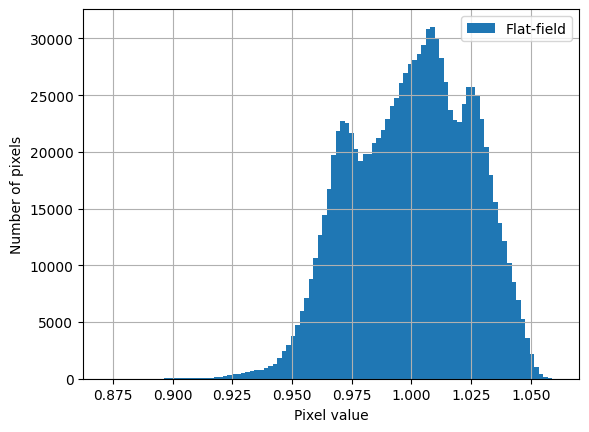

In [29]:
#4.3.4 - Plotting a histogram of the flat-field
hist(flat_image.data.flatten(), bins=100, label='Flat-field')
plt.grid()
plt.legend()
plt.xlabel('Pixel value')
plt.ylabel('Number of pixels')

4.3.5 - If flat-fields were forgotten to take on the night of the observations, they cannot be retaken later since all the previous calibrations were for a specific setup and environment. 

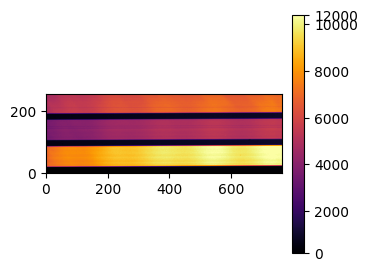

In [30]:
# 4.4.2
flat_spectro = CCDData.read('flat_fields.00000007.FIT', unit='adu')
show_image(flat_spectro.data, cmap='inferno')

In [31]:
#4.4.2 - Cutting out the images to keep only the data from the target slit of 50µm
flat_spectro = flat_spectro.data[106:176, :]
np.shape(flat_spectro)

(70, 765)

In [32]:
#4.4.2 - Making new FIT file from median array
hdu_flats2 = fits.PrimaryHDU(flat_spectro)
hdul_flats2 = fits.HDUList([hdu_flats2])
hdu_flats2.writeto('cut_spec.FIT')

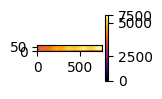

In [33]:
#4.4.2 - Displaying the cut spectrum image
spec_image = CCDData.read('cut_spec.FIT', unit='adu')
show_image(spec_image.data, cmap='inferno')

In [34]:
#4.4.3
np.size(spec_image.data.flatten())

53550

In [35]:
#4.4.3
new = np.median(spec_image.data, axis = 0)
print(np.size(new))

765


In [36]:
#4.4.3
x_pos = np.linspace(1,765,765)
print(np.size(x_pos))

765


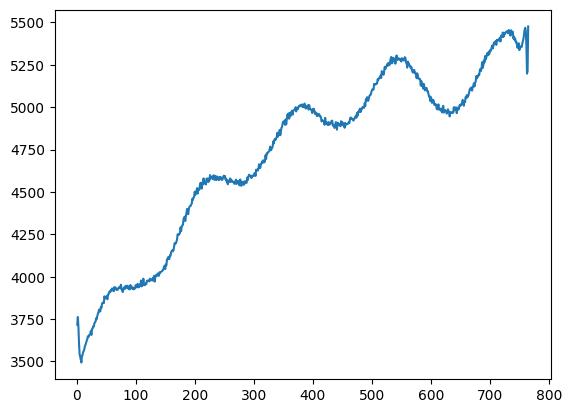

In [37]:
#4.4.3
plt.plot(x_pos,new)

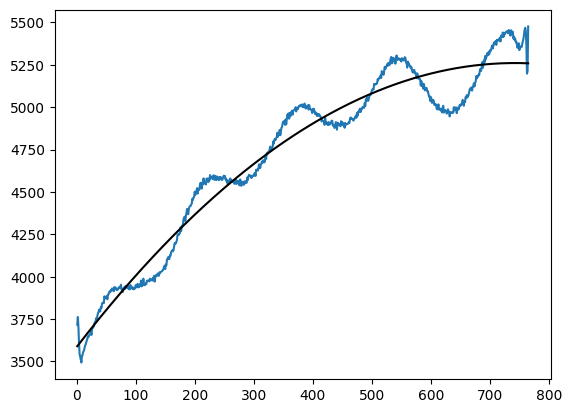

In [38]:
#4.4.3
a, b, c = np.polyfit(x_pos, new, deg=2)
xseq = np.linspace(1, 765, 765)
plt.plot(x_pos,new)
plt.plot(x_pos, a * xseq **2 + b*xseq + c, color="k", lw=1.5)

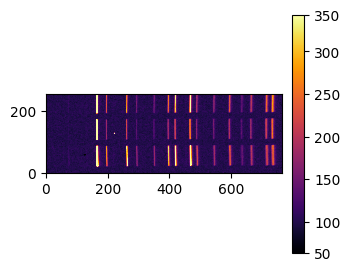

In [39]:
#4.4.4
flat_arclamp = CCDData.read('arc_lamp_spectrum.00000002.FIT', unit='adu')
show_image(flat_arclamp.data, cmap='inferno')

In [40]:
#4.4.4
flat_arclamp = flat_arclamp.data[106:176, :]
np.shape(flat_arclamp)

(70, 765)

In [41]:
#4.4.4 - Making new FIT file from array
hdu_flats2 = fits.PrimaryHDU(flat_arclamp)
hdul_flats2 = fits.HDUList([hdu_flats2])
hdu_flats2.writeto('cut_arclamp.FIT')

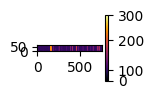

In [42]:
#4.4.4 - 
arclamp_image = CCDData.read('cut_arclamp.FIT', unit='adu')
show_image(arclamp_image.data, cmap='inferno')

In [43]:
#4.4.4 
print(np.size(arclamp_image.data))
normed_spec = arclamp_image.data/(a * xseq **2 + b*xseq + c)

53550


In [44]:
#4.4.4 - Making new FIT file from median array
hdu_flats3= fits.PrimaryHDU(normed_spec)
hdul_flats3 = fits.HDUList([hdu_flats3])
hdu_flats3.writeto('cut_arclamp_normed.FIT')

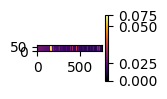

In [45]:
#4.4.4 - 
cut_arclamp_normed = CCDData.read('cut_arclamp_normed.FIT', unit='adu')
show_image(cut_arclamp_normed.data, cmap='inferno')

In [99]:
#4.4.5
pixel_value_spec = np.array([164.829, 195.5, 260.894, 292.722, 348.856, 417.144, 465.755, 486, 588, 541.565, 
                             593.648, 630.685, 662.514, 711.125, 732.537])
ex_wavelength = np.array([540.1, 585.2, 588.2, 603.0, 607.4, 616.4, 621.7, 626.6, 633.4, 638.3, 640.2, 650.6, 
                          659.9, 692.9, 703.2])

527.3100020855768 0.21115308647968006


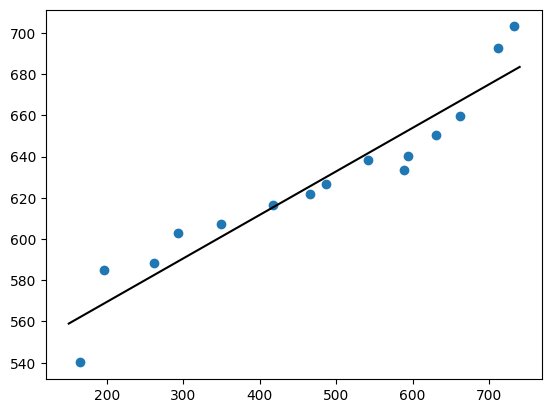

In [100]:
#4.4.5
plt.scatter(pixel_value_spec, ex_wavelength)
b, a = np.polyfit(pixel_value_spec, ex_wavelength, deg=1)
xseq = np.linspace(150, 740, 15)
plt.plot(xseq, a + b * xseq, color="k", lw=1.5)
print(a,b)
#CHECK LAST TWO POINTS

In [101]:
#4.4.5 - computed wavelengths
print(a + b * xseq)

[558.98296506 567.88155942 576.78015378 585.67874813 594.57734249
 603.47593685 612.37453121 621.27312557 630.17171993 639.07031429
 647.96890865 656.867503   665.76609736 674.66469172 683.56328608]


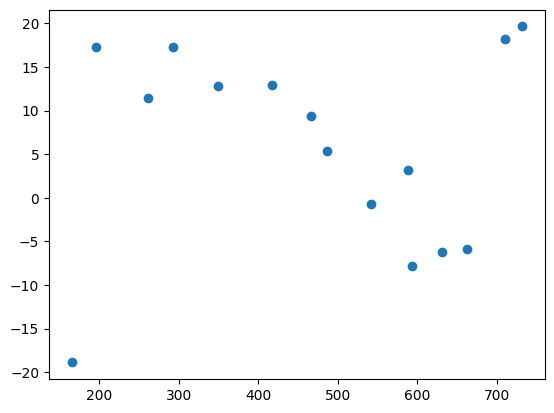

In [102]:
#4.4.5
def residual(a,b, xseq):
    return ex_wavelength - (a + b * xseq)

plt.scatter(pixel_value_spec, residual(527.3100020855768, 0.21115308647968006, xseq))

[558.98296506 567.88155942 576.78015378 585.67874813 594.57734249
 603.47593685 612.37453121 621.27312557 630.17171993 639.07031429
 647.96890865 656.867503   665.76609736 674.66469172 683.56328608]
765


Text(515, 0.07, '6213 $\\AA$')

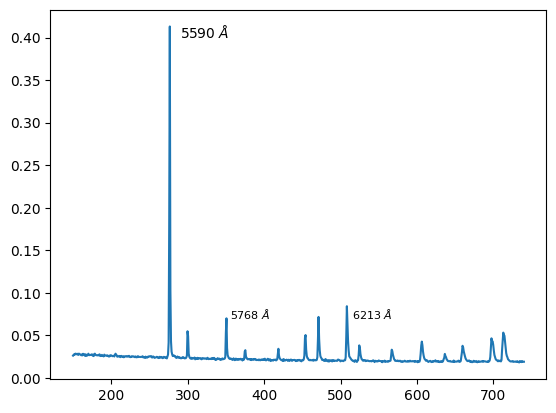

In [103]:
#4.4.6
wave = np.array(a + b * xseq)
print(wave)
new2 = np.median(cut_arclamp_normed.data, axis = 0)
print(np.size(new2))
xseq2 = np.linspace(150, 740, 765)
wavelength = np.array(a + b * xseq2)
plt.plot(xseq2, new2)
plt.text(290, 0.40, r'5590 $\AA$', fontsize = 10)
plt.text(355, 0.07, r'5768 $\AA$', fontsize = 8)
plt.text(515, 0.07, r'6213 $\AA$', fontsize = 8)

4.4.7 - dispersion is 0-765 , length of the spectrum is 6835.6 angs

4.5 - Calibration strategies


In [46]:
#4.6 - Combining 10 dark images with 30s exposure time and finding median
saturn_bdark1 = CCDData.read('saturn_blue_darks.00000040.DARK.FIT', unit='adu')
saturn_bdark2 = CCDData.read('saturn_blue_darks.00000041.DARK.FIT', unit='adu')
saturn_bdark3 = CCDData.read('saturn_blue_darks.00000042.DARK.FIT', unit='adu')
saturn_bdark4 = CCDData.read('saturn_blue_darks.00000043.DARK.FIT', unit='adu')
saturn_bdark5 = CCDData.read('saturn_blue_darks.00000044.DARK.FIT', unit='adu')
saturn_bdark6 = CCDData.read('saturn_blue_darks.00000045.DARK.FIT', unit='adu')
saturn_bdark7 = CCDData.read('saturn_blue_darks.00000046.DARK.FIT', unit='adu')
saturn_bdark8 = CCDData.read('saturn_blue_darks.00000047.DARK.FIT', unit='adu')
saturn_bdark9 = CCDData.read('saturn_blue_darks.00000048.DARK.FIT', unit='adu')
saturn_bdark10 = CCDData.read('saturn_blue_darks.00000049.DARK.FIT', unit='adu')

combiner2 = Combiner([saturn_bdark1, saturn_bdark2, saturn_bdark3, saturn_bdark4, saturn_bdark5, saturn_bdark6, saturn_bdark7,
                     saturn_bdark8, saturn_bdark9, saturn_bdark10])
combined_median2 = np.array(combiner2.median_combine())

In [47]:
#4.6 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median2)
hdul = fits.HDUList([hdu])
hdu.writeto('saturn_master_bdark1.DARK.FIT')

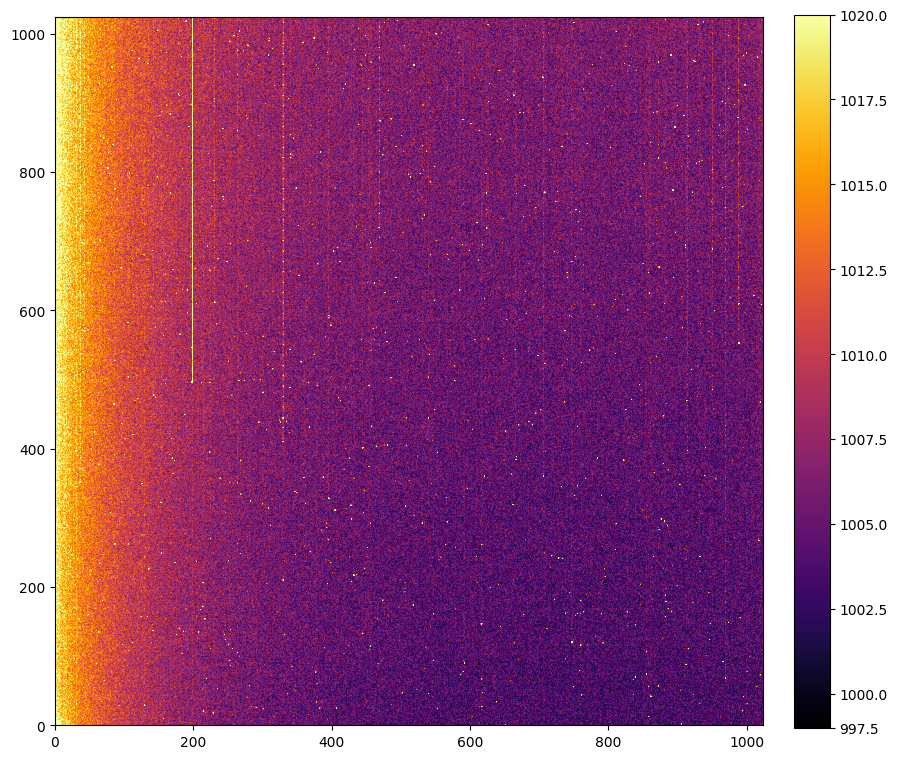

In [48]:
#4.6 - Master Blue Dark Frame
dark_blue = CCDData.read('saturn_master_bdark1.DARK.FIT', unit='adu')
show_image(dark_blue.data, cmap='inferno')

In [49]:
#4.6 - Combining 10 dark images with 30s exposure time and finding median
saturn_vdark1 = CCDData.read('saturn_visible_darks.00000010.DARK.FIT', unit='adu')
saturn_vdark2 = CCDData.read('saturn_visible_darks.00000011.DARK.FIT', unit='adu')
saturn_vdark3 = CCDData.read('saturn_visible_darks.00000012.DARK.FIT', unit='adu')
saturn_vdark4 = CCDData.read('saturn_visible_darks.00000013.DARK.FIT', unit='adu')
saturn_vdark5 = CCDData.read('saturn_visible_darks.00000014.DARK.FIT', unit='adu')
saturn_vdark6 = CCDData.read('saturn_visible_darks.00000015.DARK.FIT', unit='adu')
saturn_vdark7 = CCDData.read('saturn_visible_darks.00000016.DARK.FIT', unit='adu')
saturn_vdark8 = CCDData.read('saturn_visible_darks.00000017.DARK.FIT', unit='adu')
saturn_vdark9 = CCDData.read('saturn_visible_darks.00000018.DARK.FIT', unit='adu')
saturn_vdark10 = CCDData.read('saturn_visible_darks.00000019.DARK.FIT', unit='adu')

combiner3 = Combiner([saturn_vdark1, saturn_vdark2, saturn_vdark3, saturn_vdark4, saturn_vdark5, saturn_vdark6, saturn_vdark7,
                     saturn_vdark8, saturn_vdark9, saturn_vdark10])
combined_median3 = np.array(combiner3.median_combine())

In [50]:
#4.6 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median3)
hdul = fits.HDUList([hdu])
hdu.writeto('saturn_master_vdark1.DARK.FIT')

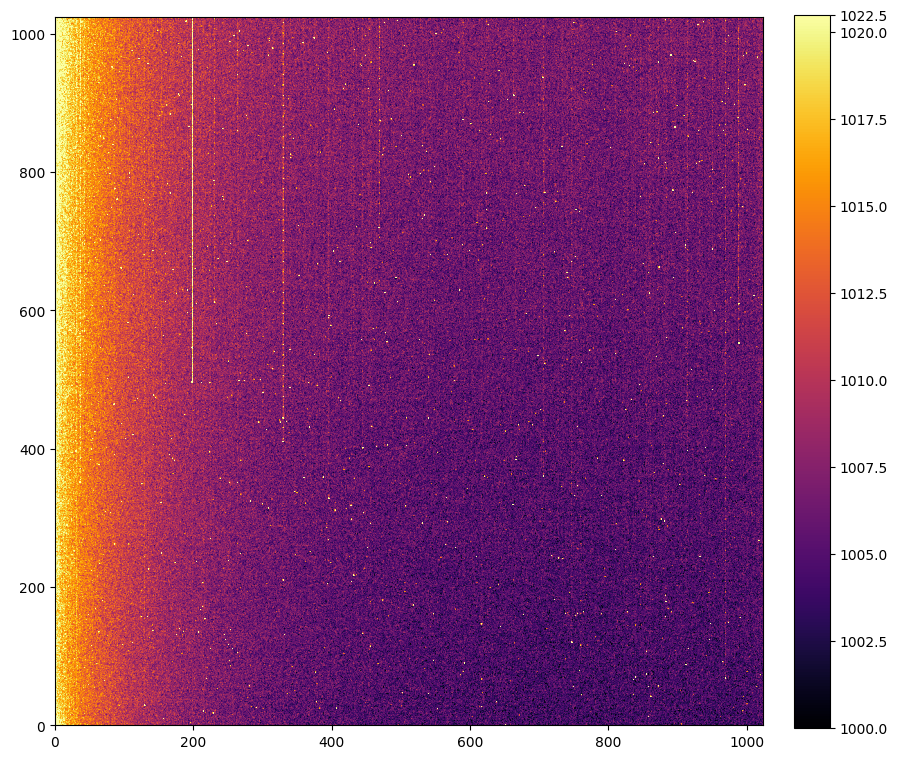

In [51]:
#4.6 - Master Blue Dark Frame
dark_visible = CCDData.read('saturn_master_vdark1.DARK.FIT', unit='adu')
show_image(dark_visible.data, cmap='inferno')

In [52]:
#4.6 - Combining 10 dark images with 30s exposure time and finding median
saturn_blue1 = CCDData.read('saturn_blue.00000030.FIT', unit='adu')
saturn_blue2 = CCDData.read('saturn_blue.00000031.FIT', unit='adu')
saturn_blue3 = CCDData.read('saturn_blue.00000032.FIT', unit='adu')
saturn_blue4 = CCDData.read('saturn_blue.00000033.FIT', unit='adu')
saturn_blue5 = CCDData.read('saturn_blue.00000034.FIT', unit='adu')
saturn_blue6 = CCDData.read('saturn_blue.00000035.FIT', unit='adu')
saturn_blue7 = CCDData.read('saturn_blue.00000036.FIT', unit='adu')
saturn_blue8 = CCDData.read('saturn_blue.00000037.FIT', unit='adu')
saturn_blue9 = CCDData.read('saturn_blue.00000038.FIT', unit='adu')
saturn_blue10 = CCDData.read('saturn_blue.00000039.FIT', unit='adu')

combiner4 = Combiner([saturn_blue1, saturn_blue2, saturn_blue3, saturn_blue4, saturn_blue5, saturn_blue6, saturn_blue7,
                     saturn_blue8, saturn_blue9, saturn_blue10])
combined_median4 = np.array(combiner4.median_combine())

In [53]:
#4.6 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median4)
hdul = fits.HDUList([hdu])
hdu.writeto('master_saturn_blue1.FIT')

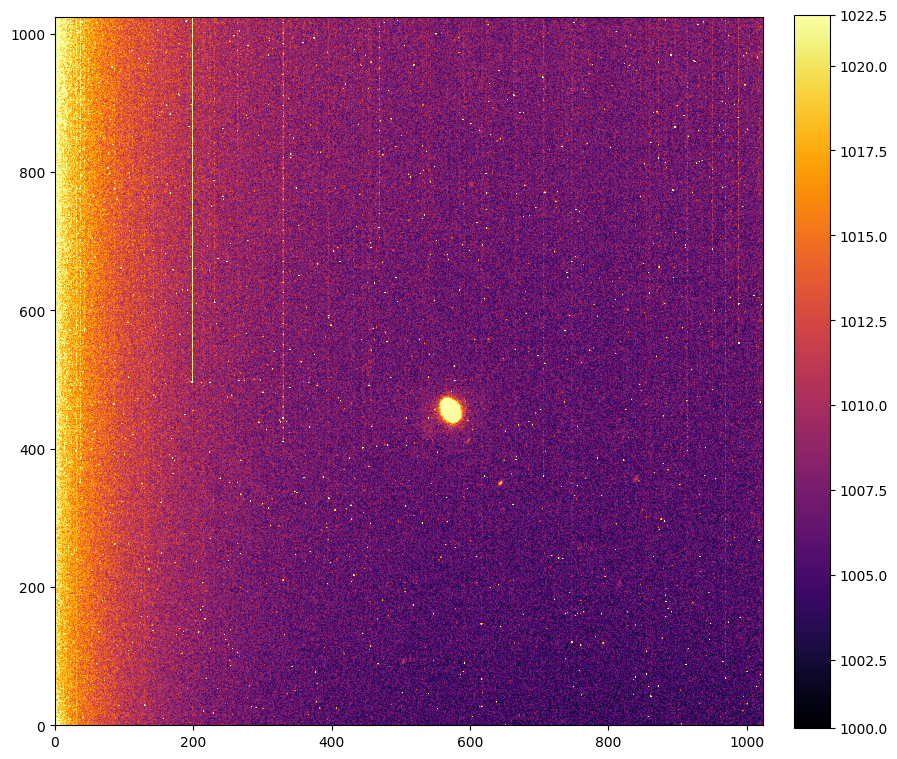

In [54]:
#4.6 - Master Blue Dark Frame
saturn_blue = CCDData.read('master_saturn_blue1.FIT', unit='adu')
show_image(saturn_blue.data, cmap='inferno')

In [55]:
#4.6 - Combining 10 dark images with 30s exposure time and finding median
saturn_visible1 = CCDData.read('saturn_visible.00000000.FIT', unit='adu')
saturn_visible2 = CCDData.read('saturn_visible.00000001.FIT', unit='adu')
saturn_visible3 = CCDData.read('saturn_visible.00000002.FIT', unit='adu')
saturn_visible4 = CCDData.read('saturn_visible.00000003.FIT', unit='adu')
saturn_visible5 = CCDData.read('saturn_visible.00000004.FIT', unit='adu')
saturn_visible6 = CCDData.read('saturn_visible.00000005.FIT', unit='adu')
saturn_visible7 = CCDData.read('saturn_visible.00000006.FIT', unit='adu')
saturn_visible8 = CCDData.read('saturn_visible.00000007.FIT', unit='adu')
saturn_visible9 = CCDData.read('saturn_visible.00000008.FIT', unit='adu')
saturn_visible10 = CCDData.read('saturn_visible.00000009.FIT', unit='adu')

combiner5 = Combiner([saturn_visible1, saturn_visible2, saturn_visible3, saturn_visible4, saturn_visible5, saturn_visible6, saturn_visible7,
                     saturn_visible8, saturn_visible9, saturn_visible10])
combined_median5 = np.array(combiner5.median_combine())

In [56]:
#4.6 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median5)
hdul = fits.HDUList([hdu])
hdu.writeto('master_saturn_visible.FIT')

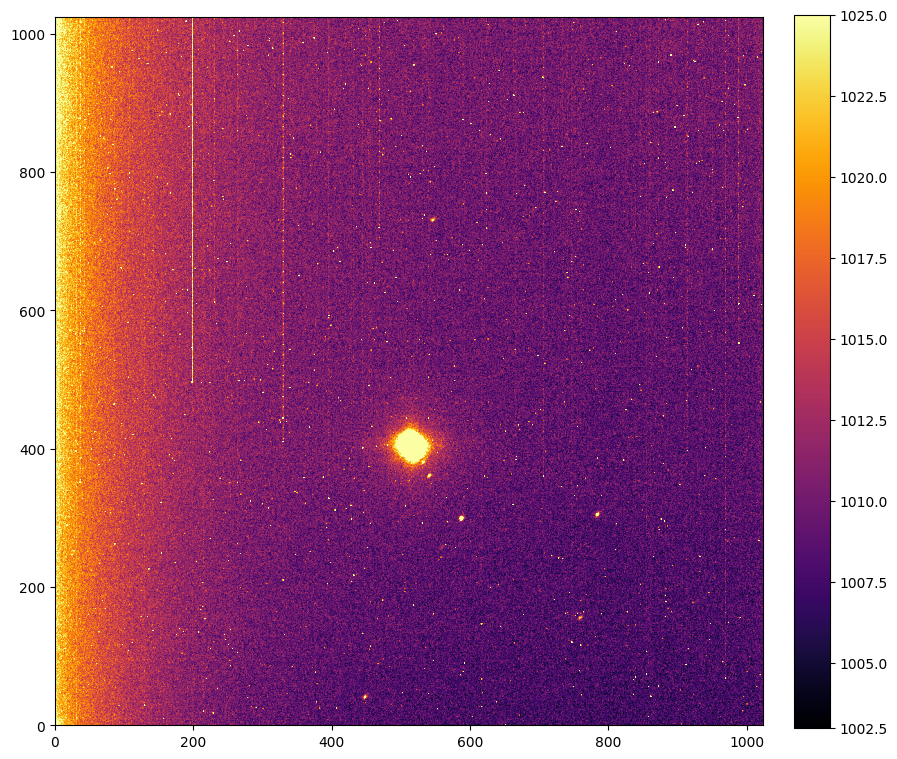

In [57]:
#4.6 - Master Blue Dark Frame
saturn_visible = CCDData.read('master_saturn_visible.FIT', unit='adu')
show_image(saturn_visible.data, cmap='inferno')

In [58]:
#4.6 - Master Red Frame
saturn_red1 = CCDData.read('saturn_red.00000020.FIT', unit='adu')
saturn_red2 = CCDData.read('saturn_red.00000021.FIT', unit='adu')
saturn_red3 = CCDData.read('saturn_red.00000022.FIT', unit='adu')
saturn_red4 = CCDData.read('saturn_red.00000023.FIT', unit='adu')
saturn_red5 = CCDData.read('saturn_red.00000024.FIT', unit='adu')
saturn_red6 = CCDData.read('saturn_red.00000025.FIT', unit='adu')
saturn_red7 = CCDData.read('saturn_red.00000026.FIT', unit='adu')
saturn_red8 = CCDData.read('saturn_red.00000027.FIT', unit='adu')
saturn_red9 = CCDData.read('saturn_red.00000028.FIT', unit='adu')
saturn_red10 = CCDData.read('saturn_red.00000029.FIT', unit='adu')

combiner = Combiner([saturn_red1, saturn_red2, saturn_red3, saturn_red4, saturn_red5, saturn_red6, saturn_red7, saturn_red8, saturn_red9, saturn_red10])
combined_median = np.array(combiner.median_combine())

In [59]:
#4.6 - Making new FIT file from median array
hdu = fits.PrimaryHDU(combined_median)
hdul = fits.HDUList([hdu])
hdu.writeto('master_red_frame_100s.FIT')

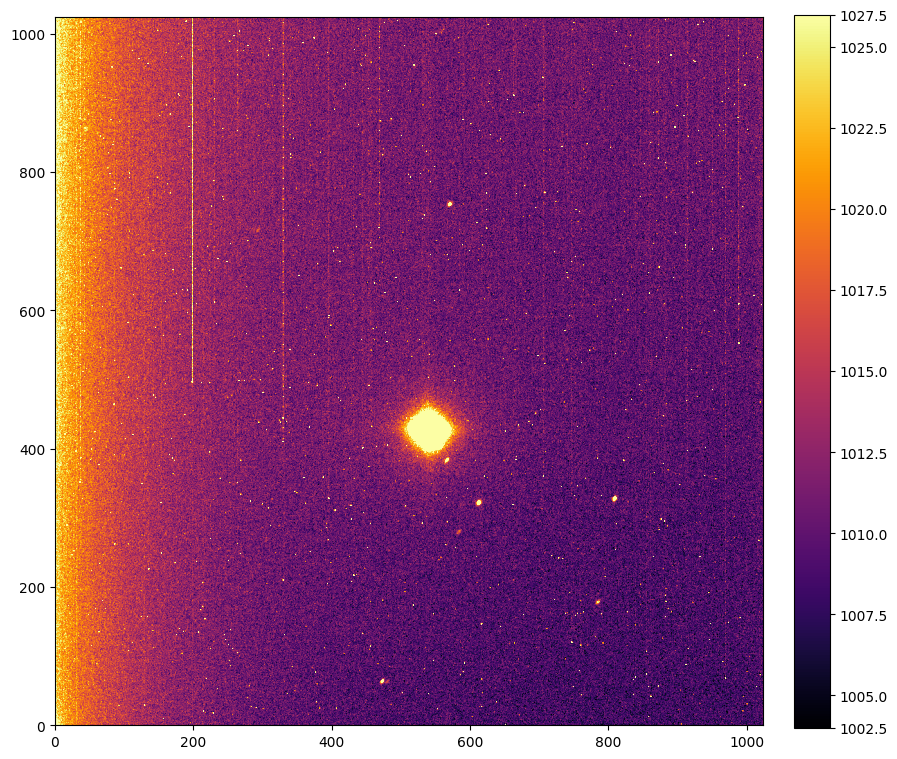

In [60]:
#4.6 
red_image = CCDData.read('master_red_frame_100s.FIT', unit='adu')
show_image(red_image.data, cmap='inferno')

In [138]:
#4.6
import astroalign as aa
source = red_image.data
target = saturn_visible.data
target = target.byteswap().newbyteorder()
source = source.byteswap().newbyteorder()
registered, footprint = aa.register(source, target)

In [145]:
print(red_image.data.min())
print(saturn_visible.data.min())
print(saturn_blue.data.min())

996.5
997.0
992.5


In [151]:
stacked3 = np.array([red_image.data/red_image.data.max(), saturn_visible.data/saturn_visible.data.max(), saturn_blue.data/saturn_blue.data.max()])
np.shape(stacked3)
empty = np.zeros((1024,1024,3))
empty[:,:,0] = stacked3[0]
empty[:,:,1] = stacked3[1]
empty[:,:,2] = stacked3[2]

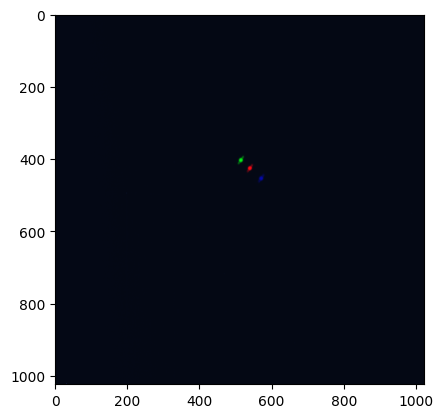

In [152]:
plt.imshow(empty)

In [62]:
#4.6
hdu_align = fits.PrimaryHDU(registered)
hdul_align = fits.HDUList([hdu_align])
hdu_align.writeto('aligned.FIT')

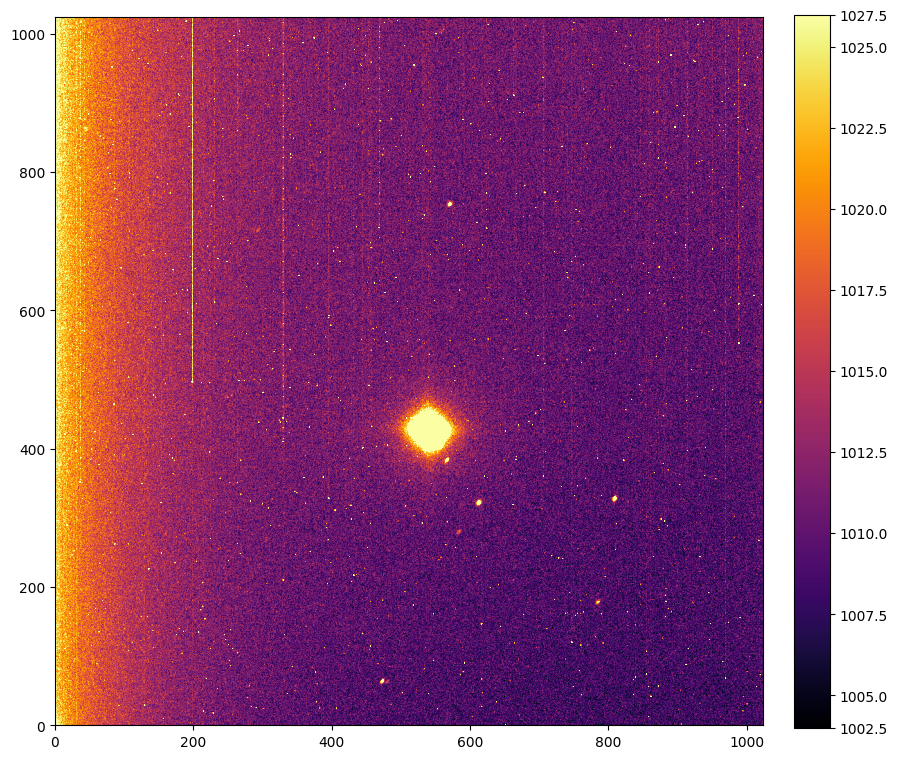

In [84]:
#4.6
aligned_image = CCDData.read('aligned.FIT', unit='adu')
show_image(aligned_image.data, cmap='inferno')
# DONT NEED TO SUBTRACT BOTH BIAS AND DARK, ONLY DARK
#NO HEAT MAP
#TRY DS9 STUFF
#MATPLOTLIB FUNCTION TO STACK STUFF IN RGB
# ^^ WILL NEED TO SCALE STUFF DOWN

In [85]:
#4.6
source2 = aligned_image.data
target2 = saturn_blue.data
target2 = target2.byteswap().newbyteorder()
source2 = source2.byteswap().newbyteorder()
registered2, footprint2 = aa.register(source2, target2)

In [86]:
#4.6
hdu_align_final = fits.PrimaryHDU(registered2)
hdul_align_final = fits.HDUList([hdu_align_final])
hdu_align_final.writeto('final_aligned.FIT')

OSError: File final_aligned.FIT already exists. If you mean to replace it then use the argument "overwrite=True".

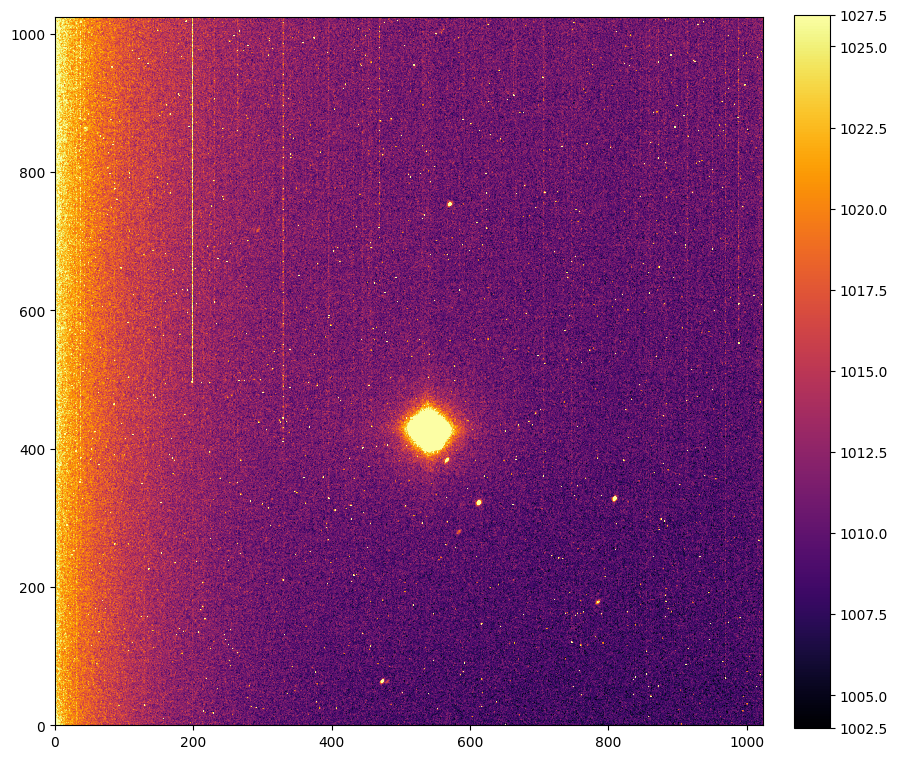

In [87]:
#4.6
final_aligned_image = CCDData.read('final_aligned.FIT', unit='adu')
show_image(final_aligned_image.data, cmap='inferno')

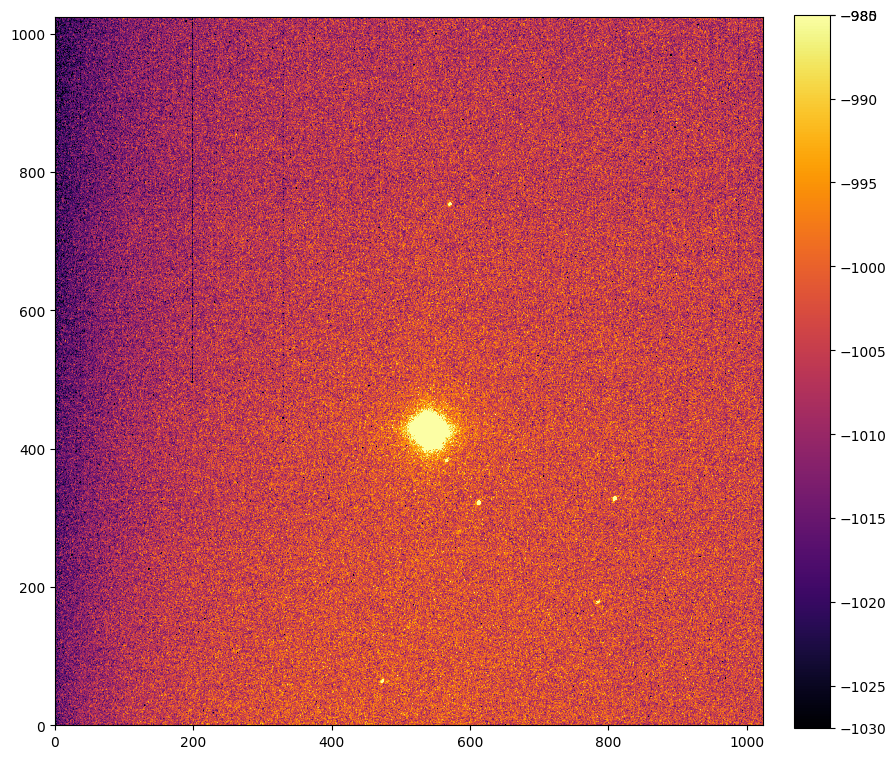

In [104]:
#4.6
sci_image = final_aligned_image.data - bias_image.data - dark_visible.data
show_image(sci_image.data, cmap='inferno')

In [96]:
#4.6 Blue Flat
blue_flat1 = CCDData.read('flat_fields_frame_blue.00000015.FIT', unit='adu')
blue_flat2 = CCDData.read('flat_fields_frame_blue.00000016.FIT', unit='adu')
blue_flat3 = CCDData.read('flat_fields_frame_blue.00000017.FIT', unit='adu')
blue_flat4 = CCDData.read('flat_fields_frame_blue.00000018.FIT', unit='adu')
blue_flat5 = CCDData.read('flat_fields_frame_blue.00000019.FIT', unit='adu')
blue_flat6 = CCDData.read('flat_fields_frame_blue.00000020.FIT', unit='adu')
blue_flat7 = CCDData.read('flat_fields_frame_blue.00000021.FIT', unit='adu')
blue_flat8 = CCDData.read('flat_fields_frame_blue.00000022.FIT', unit='adu')
blue_flat9 = CCDData.read('flat_fields_frame_blue.00000023.FIT', unit='adu')
blue_flat10 = CCDData.read('flat_fields_frame_blue.00000024.FIT', unit='adu')
blue_flat11 = CCDData.read('flat_fields_frame_blue.00000025.FIT', unit='adu')
blue_flat12 = CCDData.read('flat_fields_frame_blue.00000026.FIT', unit='adu')

combiner_blue_flats = Combiner([blue_flat1, blue_flat2, blue_flat3, blue_flat4, blue_flat5, blue_flat6, blue_flat7, blue_flat8, blue_flat9, blue_flat10, blue_flat11, blue_flat12])
combined_blue_median_flats = np.array(combiner_blue_flats.median_combine())
mean_blue_flats = np.mean(combined_blue_median_flats)
normed_blue = combined_blue_median_flats/mean_blue_flats

In [97]:
#4.6 - Making new FIT file from median array
hdu4 = fits.PrimaryHDU(normed_blue)
hdul4 = fits.HDUList([hdu4])
hdu4.writeto('master_blue_flat.FIT')

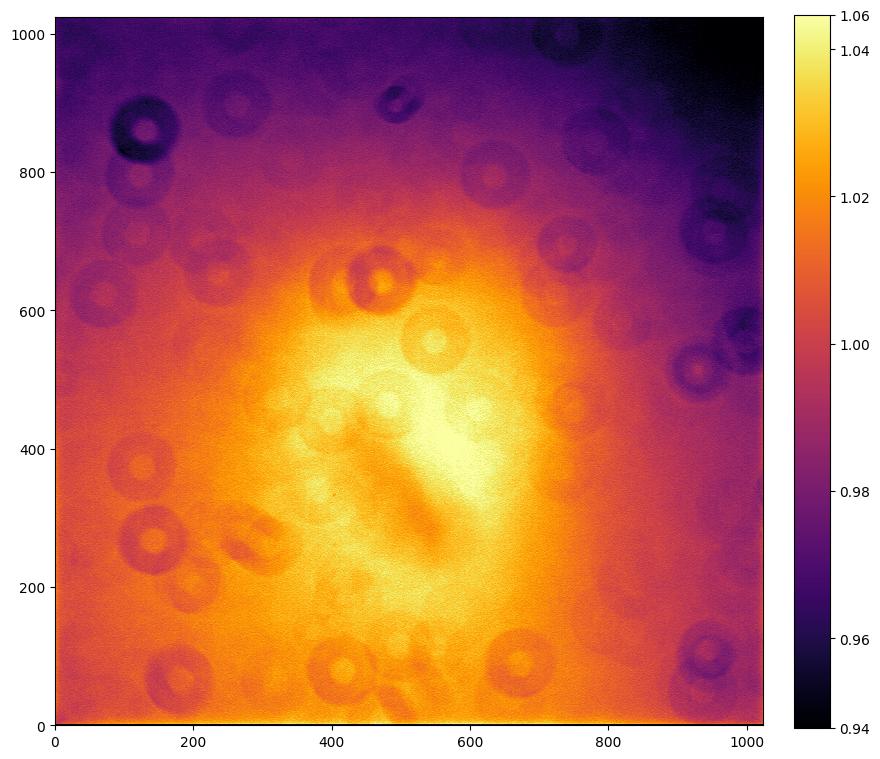

In [98]:
#4.6
final_blue_flat = CCDData.read('master_blue_flat.FIT', unit='adu')
show_image(final_blue_flat.data, cmap='inferno')

In [106]:
#4.6
red_flat1 = CCDData.read('flat_fields_frame_red.00000027.FIT', unit='adu')
red_flat2 = CCDData.read('flat_fields_frame_red.00000028.FIT', unit='adu')
red_flat3 = CCDData.read('flat_fields_frame_red.00000029.FIT', unit='adu')
red_flat4 = CCDData.read('flat_fields_frame_red.00000030.FIT', unit='adu')
red_flat5 = CCDData.read('flat_fields_frame_red.00000031.FIT', unit='adu')
red_flat6 = CCDData.read('flat_fields_frame_red.00000032.FIT', unit='adu')
red_flat7 = CCDData.read('flat_fields_frame_red.00000033.FIT', unit='adu')
red_flat8 = CCDData.read('flat_fields_frame_red.00000034.FIT', unit='adu')
red_flat9 = CCDData.read('flat_fields_frame_red.00000035.FIT', unit='adu')
red_flat10 = CCDData.read('flat_fields_frame_red.00000036.FIT', unit='adu')
red_flat11 = CCDData.read('flat_fields_frame_red.00000037.FIT', unit='adu')
red_flat12 = CCDData.read('flat_fields_frame_red.00000038.FIT', unit='adu')
red_flat13 = CCDData.read('flat_fields_frame_red.00000039.FIT', unit='adu')

combiner_flats_red = Combiner([red_flat1, red_flat2, red_flat3, red_flat4, red_flat5, red_flat6, red_flat7, red_flat8, red_flat9, red_flat10, red_flat11, red_flat12, red_flat13])
combined_median_flats_red = np.array(combiner_flats_red.median_combine())
mean_flats_red = np.mean(combined_median_flats_red)
normed_red = combined_median_flats_red/mean_flats_red

In [107]:
#4.6
hdu5 = fits.PrimaryHDU(normed_red)
hdul5 = fits.HDUList([hdu5])
hdu5.writeto('master_flat_red.FIT')

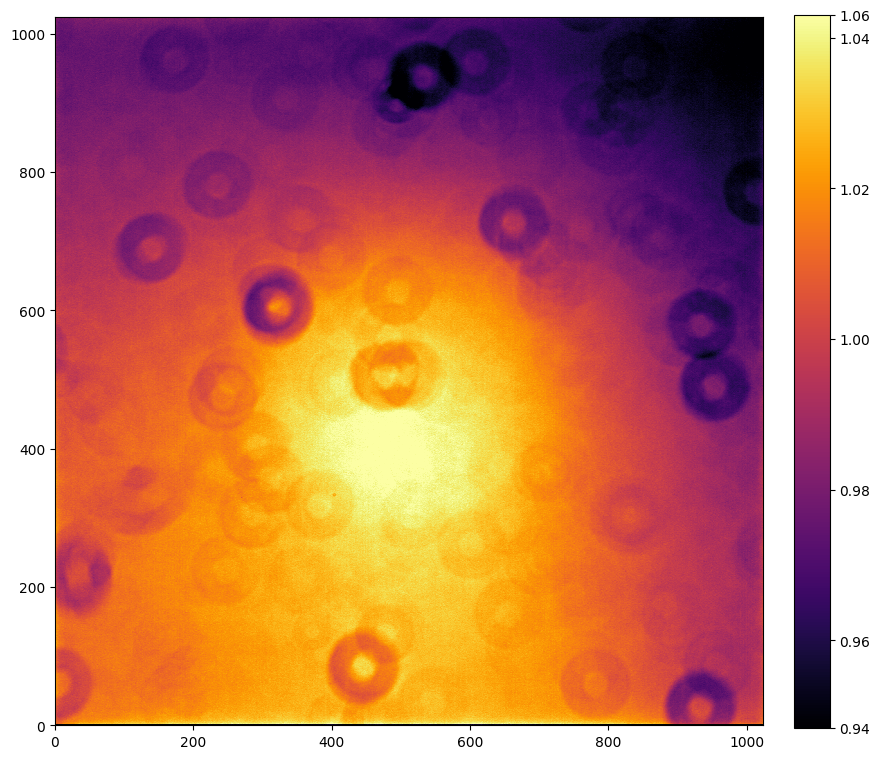

In [108]:
#4.6
red_image_flat = CCDData.read('master_flat_red.FIT', unit='adu')
show_image(red_image_flat.data, cmap='inferno')

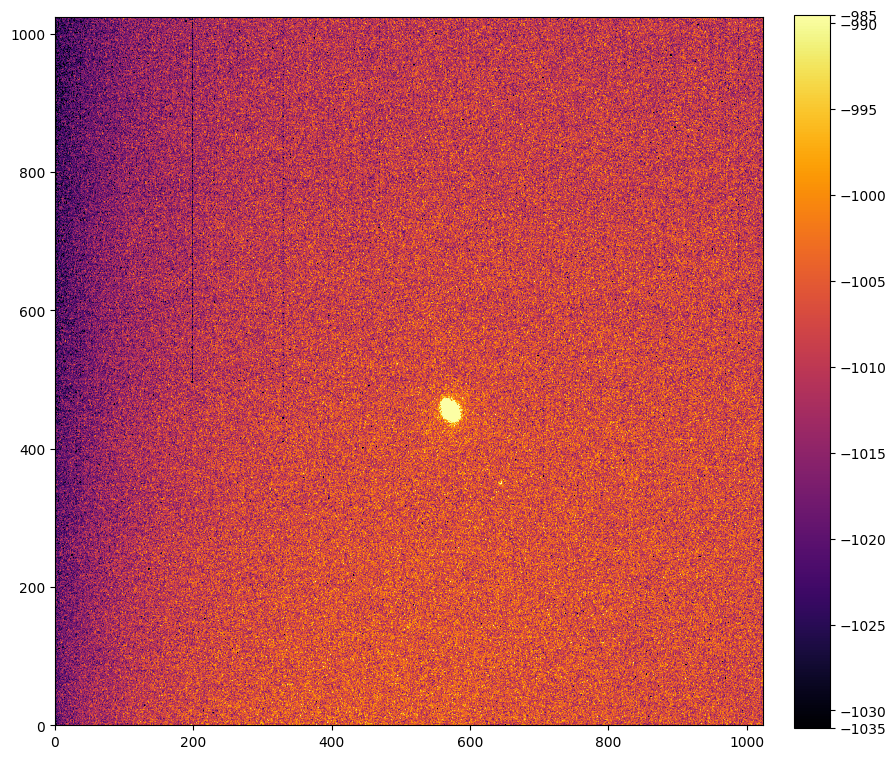

In [118]:
#4.6 
blue_sub = saturn_blue.data - bias_image.data - dark_visible.data
show_image(blue_sub.data, cmap='inferno')

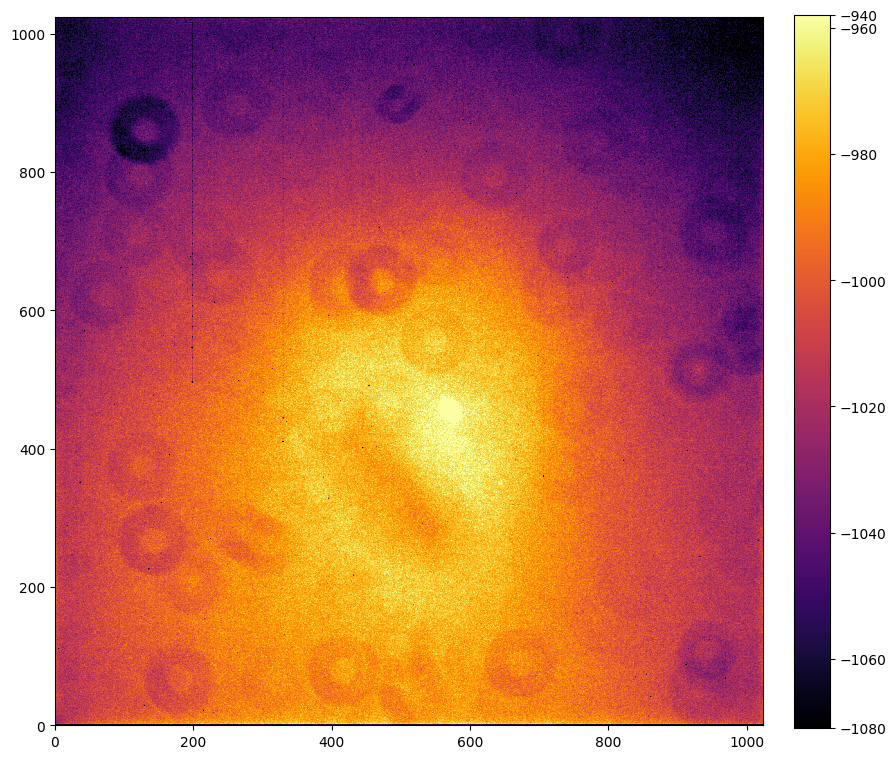

In [119]:
#4.6
final_blue = blue_sub.data / final_blue_flat.data
show_image(final_blue, cmap='inferno')

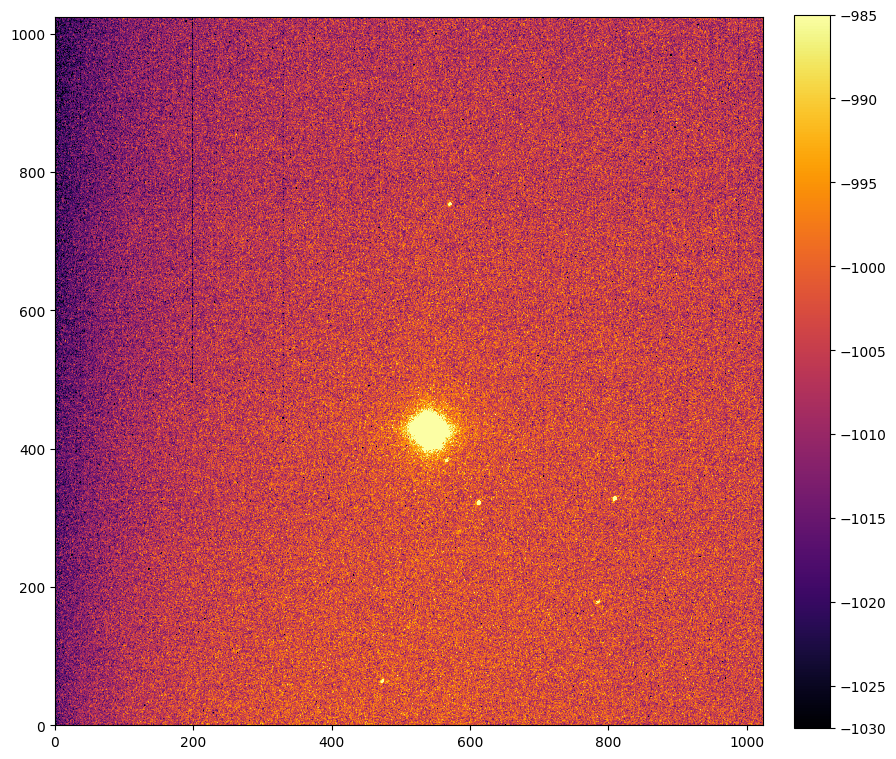

In [121]:
#4.6 
red_sub = red_image.data - bias_image.data - dark_visible.data
show_image(red_sub.data, cmap='inferno')

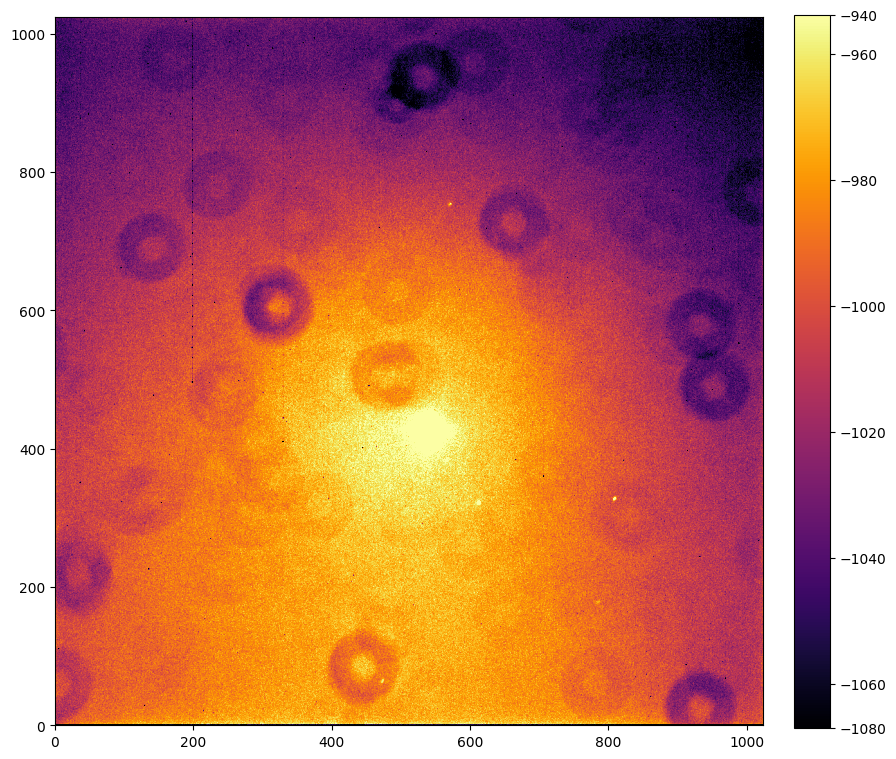

In [140]:
#4.6
final_red = red_sub.data / red_image_flat.data
show_image(final_red, cmap='inferno')

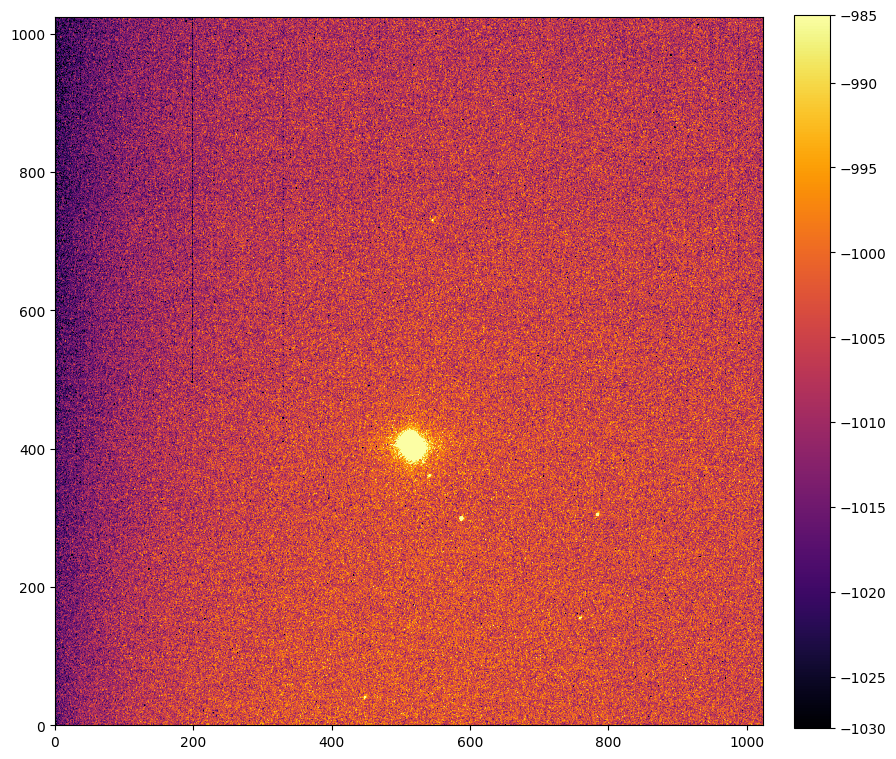

In [123]:
#4.6 
visible_sub = saturn_visible.data - bias_image.data - dark_visible.data
show_image(visible_sub.data, cmap='inferno')

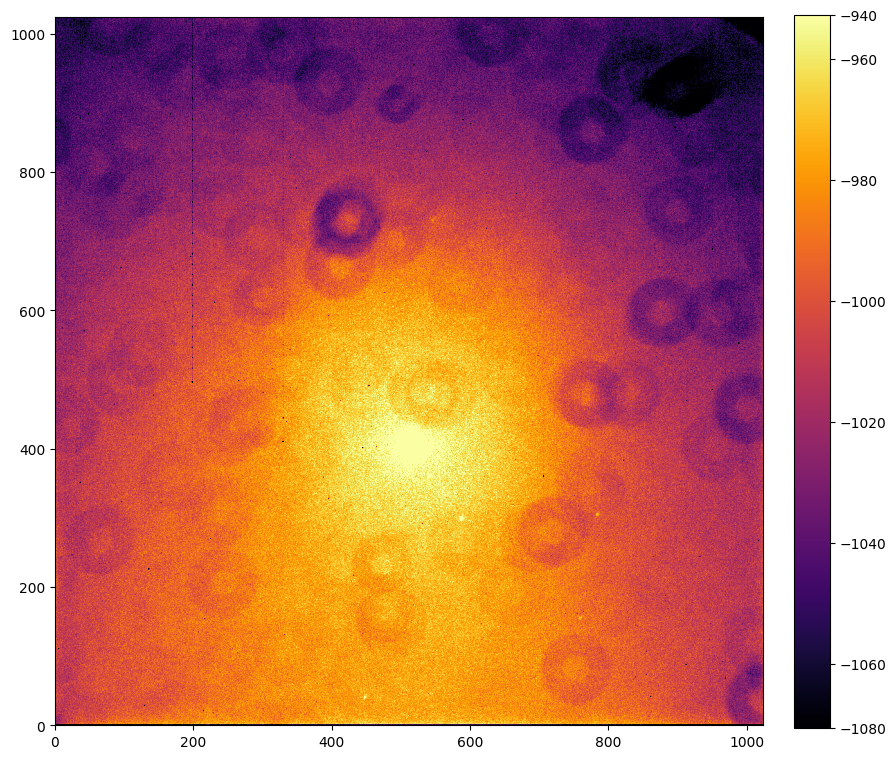

In [126]:
#4.6
final_visible = visible_sub.data / flat_image.data
show_image(final_visible.data, cmap='inferno')

In [142]:
import astroalign as aa
source3 = (final_blue)
target3 = (final_red)
target3 = target3.byteswap().newbyteorder()
source3 = source3.byteswap().newbyteorder()
registered3, footprint3 = aa.register(source3, target3)

ValueError: Reference stars in source image are less than the minimum value (3).

In [125]:
#4.6
hdu_align2 = fits.PrimaryHDU(registered)
hdul_align2 = fits.HDUList([hdu_align2])
hdu_align2.writeto('aligned_sub.FIT')

In [ ]:
#4.6
final_aligned_image = CCDData.read('final_aligned.FIT', unit='adu')
show_image(final_aligned_image.data, cmap='inferno')